<a href="https://colab.research.google.com/github/SolKidonakis/AA2TP1/blob/main/AA2Problema2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install mediapipe opencv-python-headless tensorflow numpy


In [25]:
import cv2
import numpy as np
import mediapipe as mp
import matplotlib.pyplot as plt
import os
from google.colab import drive
from google.colab import files
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.model_selection import train_test_split

from google.colab.patches import cv2_imshow
from scipy.spatial import distance

In [ ]:


uploaded = files.upload()


Saving Gestos.mp4 to Gestos.mp4


In [ ]:
from google.colab.patches import cv2_imshow

Introduce el número del gesto (0: piedra, 1: papel, 2: tijeras): 1


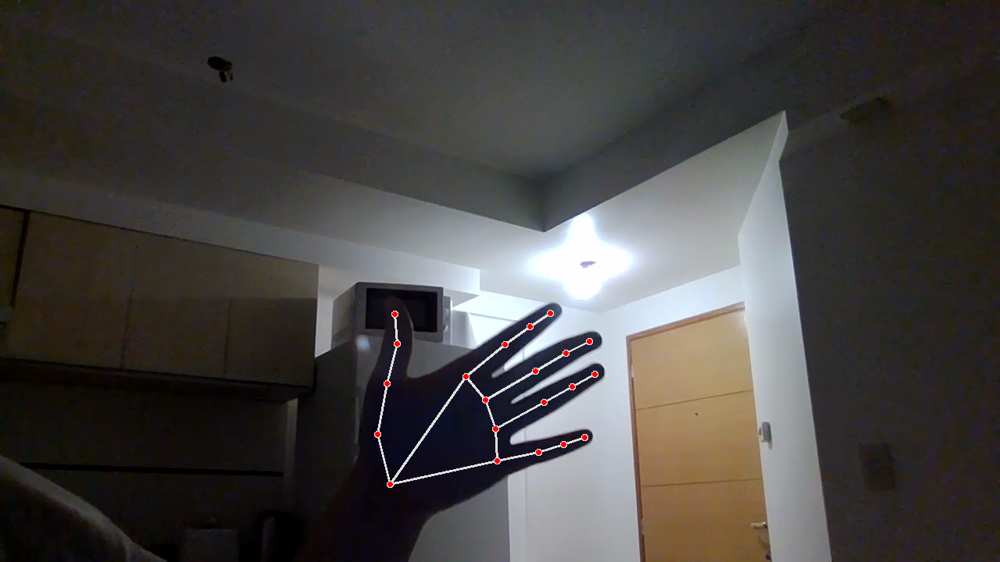

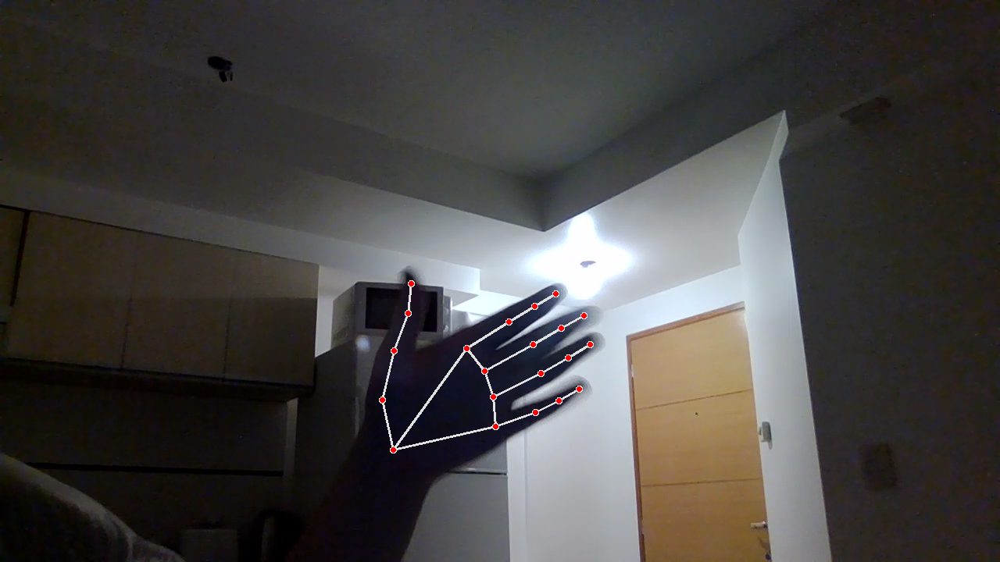

Introduce el número del gesto (0: piedra, 1: papel, 2: tijeras): 1


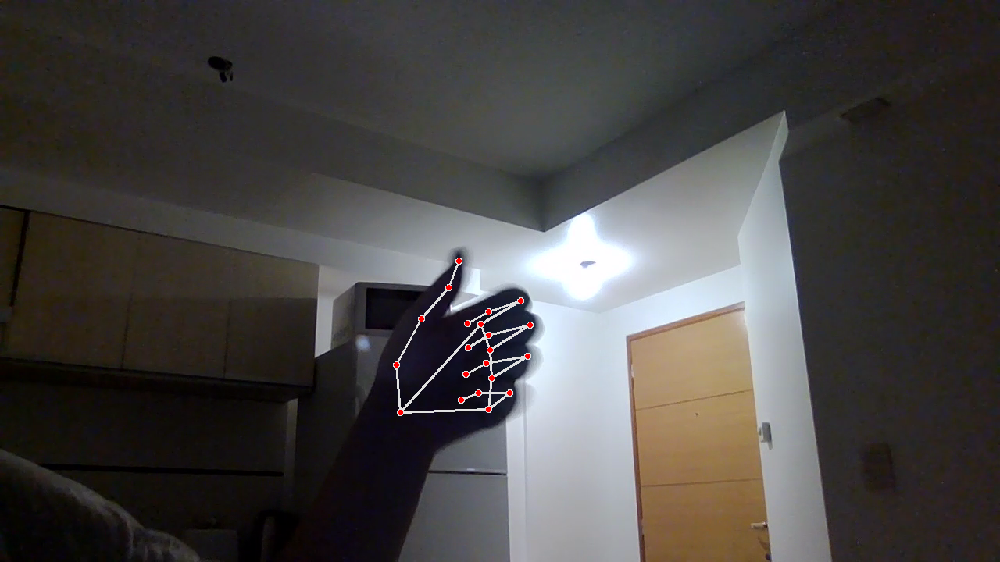

Introduce el número del gesto (0: piedra, 1: papel, 2: tijeras): 0


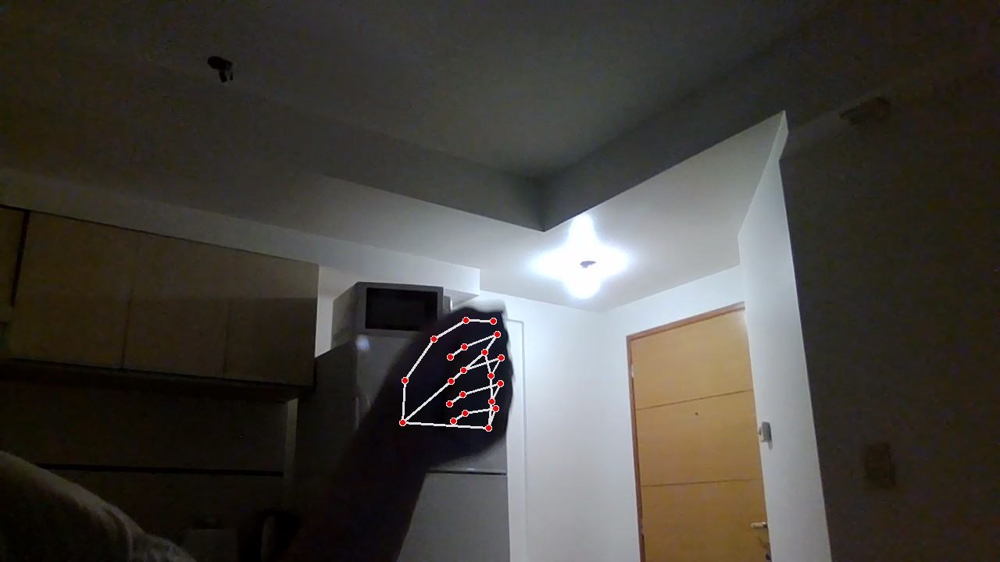

Introduce el número del gesto (0: piedra, 1: papel, 2: tijeras): 0


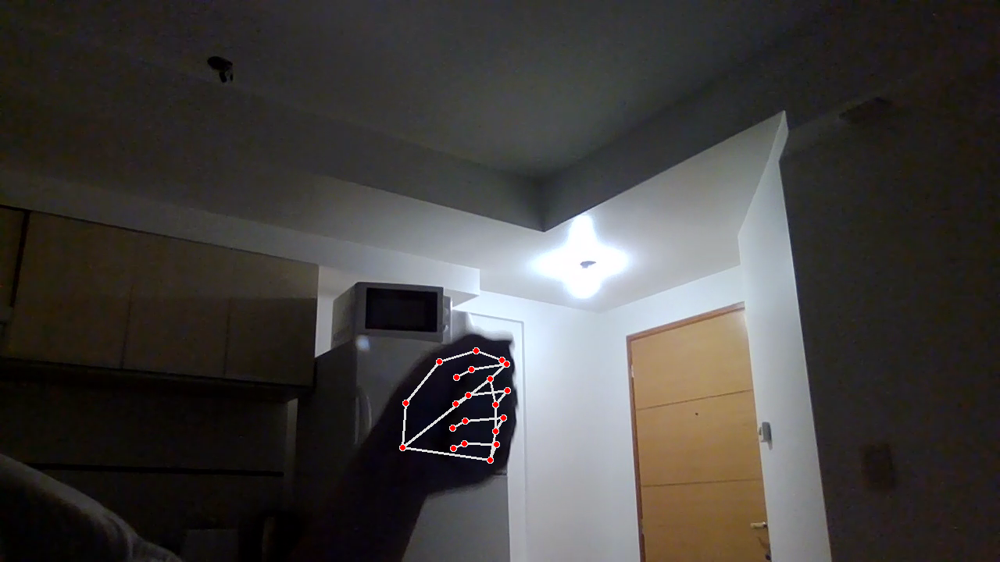

Introduce el número del gesto (0: piedra, 1: papel, 2: tijeras): 0


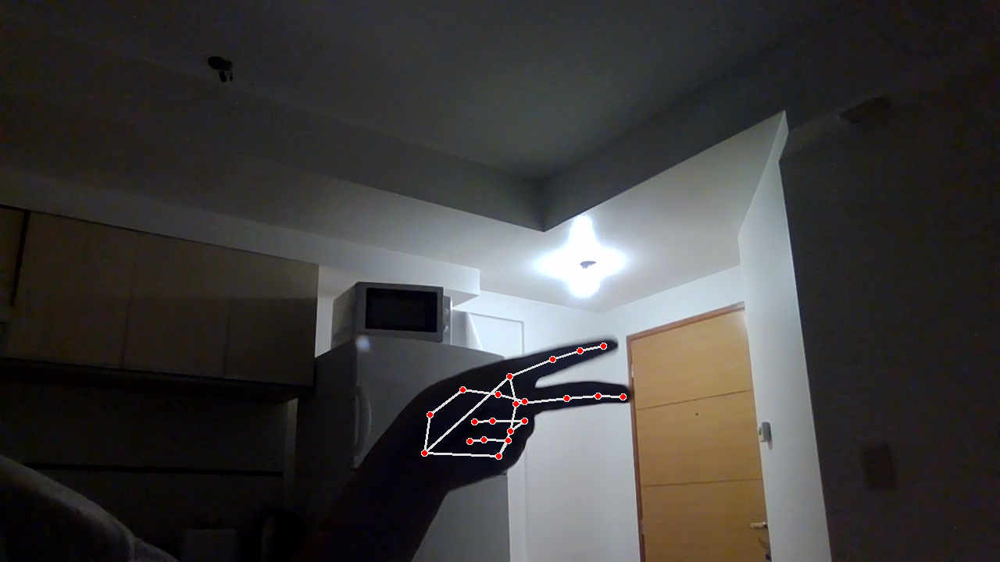

Introduce el número del gesto (0: piedra, 1: papel, 2: tijeras): 2


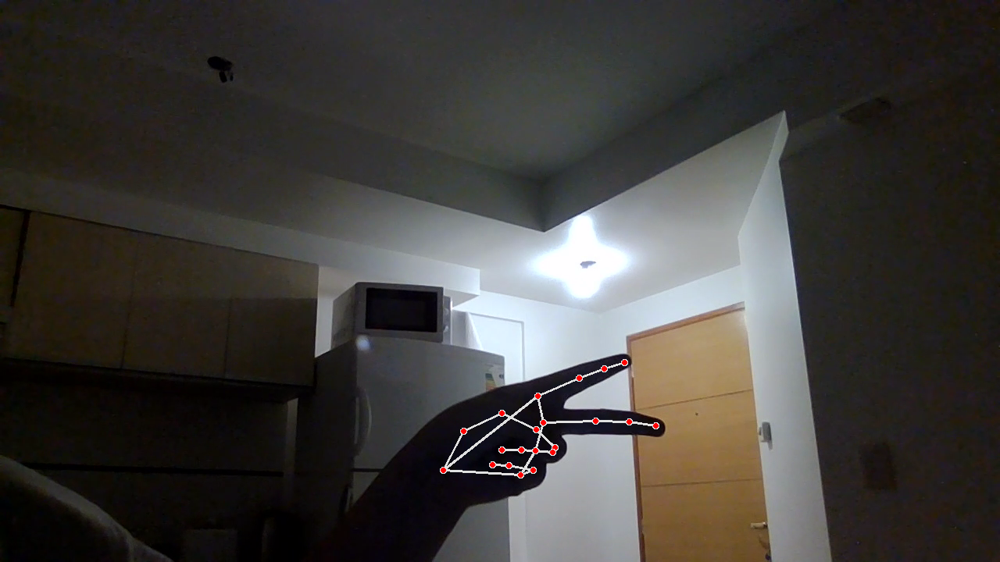

Introduce el número del gesto (0: piedra, 1: papel, 2: tijeras): 2
Procesando frame: 100
Dataset guardado exitosamente.


In [24]:

# Inicializar MediaPipe y el detector de manos
mp_hands = mp.solutions.hands
hands = mp_hands.Hands(static_image_mode=False, max_num_hands=1, min_detection_confidence=0.7)
mp_drawing = mp.solutions.drawing_utils

video_path = 'Gestos.mp4'
cap = cv2.VideoCapture(video_path)

landmarks_data = []
labels = []
previous_landmark_coords = None  # Almacenar los landmarks del frame anterior

# Umbral de cambio entre gestos
change_threshold = 0.05

frame_counter = 0

# Función para calcular el cambio entre dos gestos usando la distancia euclidiana
def gesture_changed(landmarks1, landmarks2, threshold):
    total_distance = 0
    for lm1, lm2 in zip(landmarks1, landmarks2):
        total_distance += distance.euclidean(lm1, lm2)
    average_distance = total_distance / len(landmarks1)
    return average_distance > threshold

# Recorrer los frames del video
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    frame_counter += 1

    # Convertir el frame a RGB
    image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = hands.process(image)

    # Si se detecta una mano
    if results.multi_hand_landmarks:
        for hand_landmarks in results.multi_hand_landmarks:
            # Extraer las coordenadas de los landmarks
            landmark_coords = []
            for landmark in hand_landmarks.landmark:
                landmark_coords.append([landmark.x, landmark.y])

            # Si no hay un gesto previo almacenado, guardamos el primero
            if previous_landmark_coords is None:
                previous_landmark_coords = landmark_coords
                continue

            # Comparamos los landmarks del frame actual con los del anterior
            if gesture_changed(previous_landmark_coords, landmark_coords, change_threshold):
                # Dibujar los landmarks en la imagen
                mp_drawing.draw_landmarks(frame, hand_landmarks, mp_hands.HAND_CONNECTIONS)

                cv2_imshow(frame)

                gesture = input("Introduce el número del gesto (0: piedra, 1: papel, 2: tijeras): ")

                # Almacenar los landmarks y la etiqueta correspondiente
                landmarks_data.append(landmark_coords)
                labels.append(int(gesture))

                # Actualizamos los landmarks previos
                previous_landmark_coords = landmark_coords


    if frame_counter % 100 == 0:
        print(f"Procesando frame: {frame_counter}")

# Convertir los datos a numpy arrays
landmarks_data = np.array(landmarks_data)
labels = np.array(labels)


np.save('rps_dataset.npy', landmarks_data)
np.save('rps_labels.npy', labels)

cap.release()
print("Dataset guardado exitosamente.")


In [26]:


# Cargar los datos del dataset
landmarks_data = np.load('rps_dataset.npy')
labels = np.load('rps_labels.npy')

# Convertir las coordenadas en un array plano (de 21 puntos x 2 coordenadas = 42 features por muestra)
X = landmarks_data.reshape(len(landmarks_data), -1)

# Dividir los datos en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, labels, test_size=0.2, random_state=42)

# Crear el modelo de red neuronal densa
model = Sequential()
model.add(Dense(128, activation='relu', input_shape=(42,)))  # 42 entradas (21 puntos x 2 coordenadas)
model.add(Dense(64, activation='relu'))
model.add(Dense(3, activation='softmax'))  # 3 clases: piedra (0), papel (1), tijeras (2)

# Compilar el modelo
model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Entrenar el modelo
model.fit(X_train, y_train, epochs=20, validation_data=(X_test, y_test))

# Evaluar el modelo en el set de prueba
test_loss, test_acc = model.evaluate(X_test, y_test, verbose=2)
print(f"Precisión en el conjunto de prueba: {test_acc:.4f}")

# Guardar el modelo entrenado
model.save('rps_model.h5')


/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - accuracy: 0.6000 - loss: 1.0270 - val_accuracy: 0.0000e+00 - val_loss: 1.4171
Epoch 2/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - accuracy: 0.4000 - loss: 0.9568 - val_accuracy: 0.0000e+00 - val_loss: 1.5614
Epoch 3/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step - accuracy: 0.6000 - loss: 0.9108 - val_accuracy: 0.0000e+00 - val_loss: 1.7038
Epoch 4/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - accuracy: 0.6000 - loss: 0.8753 - val_accuracy: 0.0000e+00 - val_loss: 1.8403
Epoch 5/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step - accuracy: 0.6000 - loss: 0.8437 - val_accuracy: 0.0000e+00 - val_loss: 1.9744
Epoch 6/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 83ms/step - accuracy: 0.6000 - loss: 0.8172 - val_accuracy: 0.0000e+00 - val_loss: 2.1154
Epoch 7/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 118ms/step - accuracy: 0.6000 - loss: 0.7944 - val_accuracy: 0.0000e+00 - val_loss: 2.2645
Epoch 8/20
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.6000 - loss: 0.7740 - val_accuracy

Precisión en el conjunto de prueba: 0.0000


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step


/usr/local/lib/python3.10/dist-packages/google/protobuf/symbol_database.py:55: UserWarning: SymbolDatabase.GetPrototype() is deprecated. Please use message_factory.GetMessageClass() instead. SymbolDatabase.GetPrototype() will be removed soon.
  warnings.warn('SymbolDatabase.GetPrototype() is deprecated. Please '


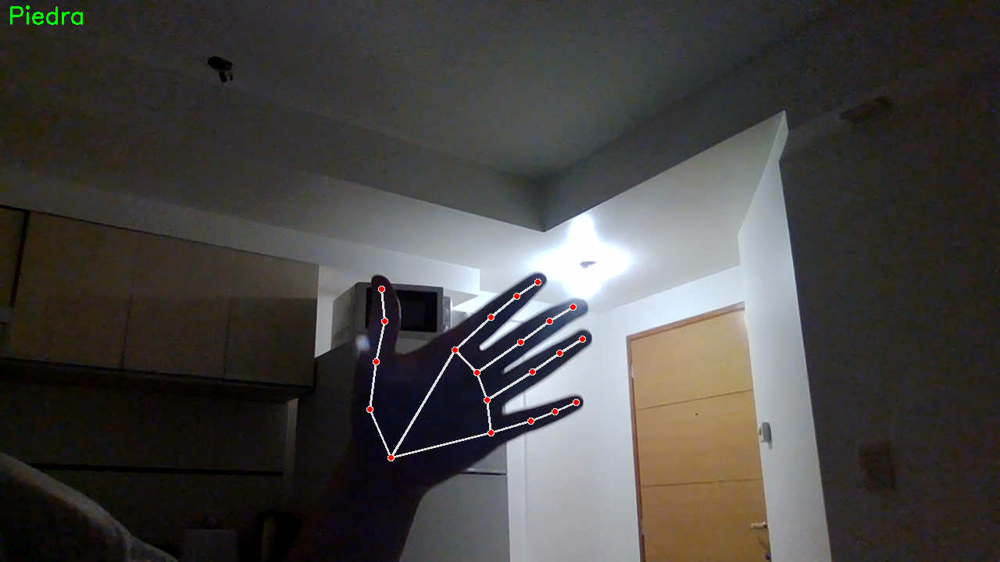

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step


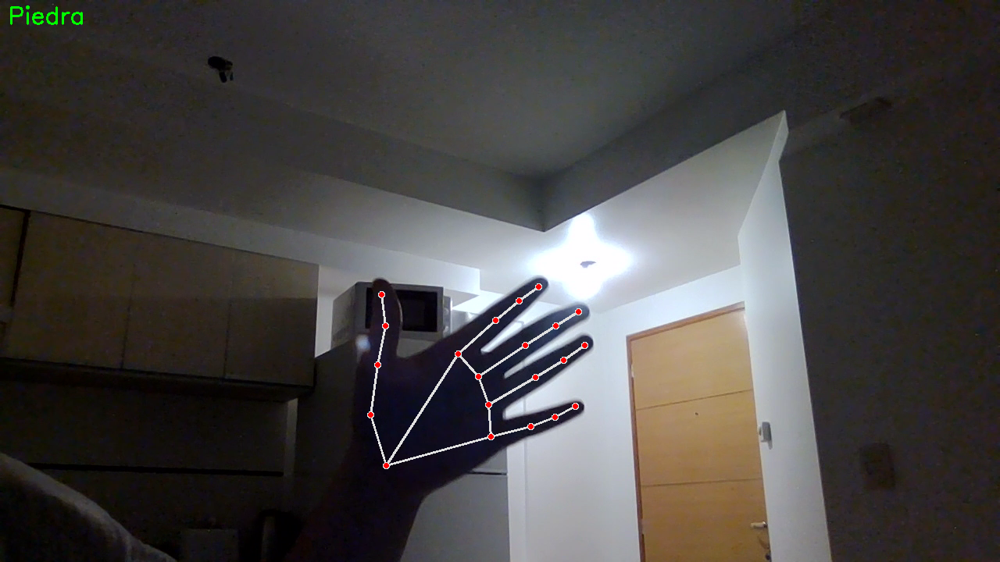

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


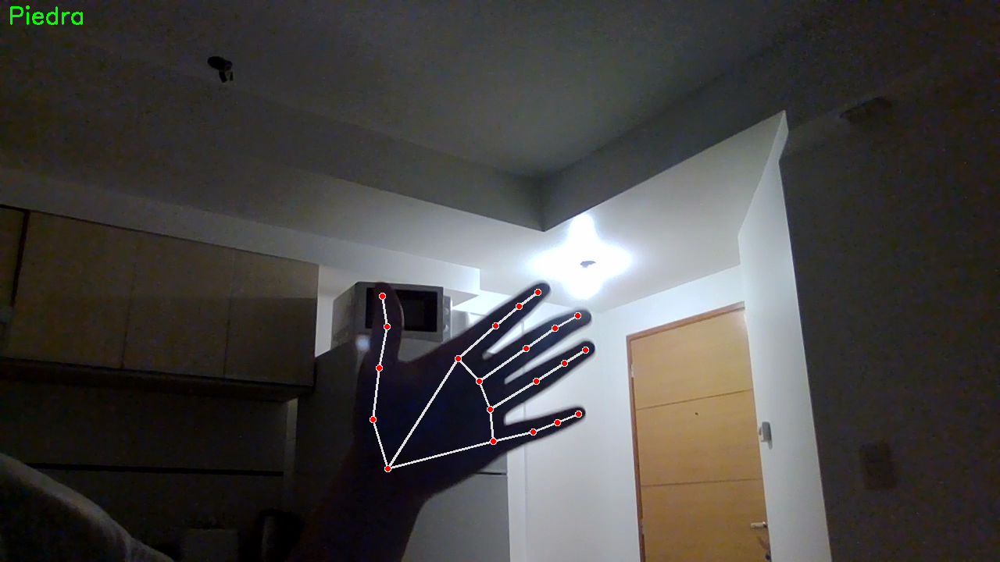

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


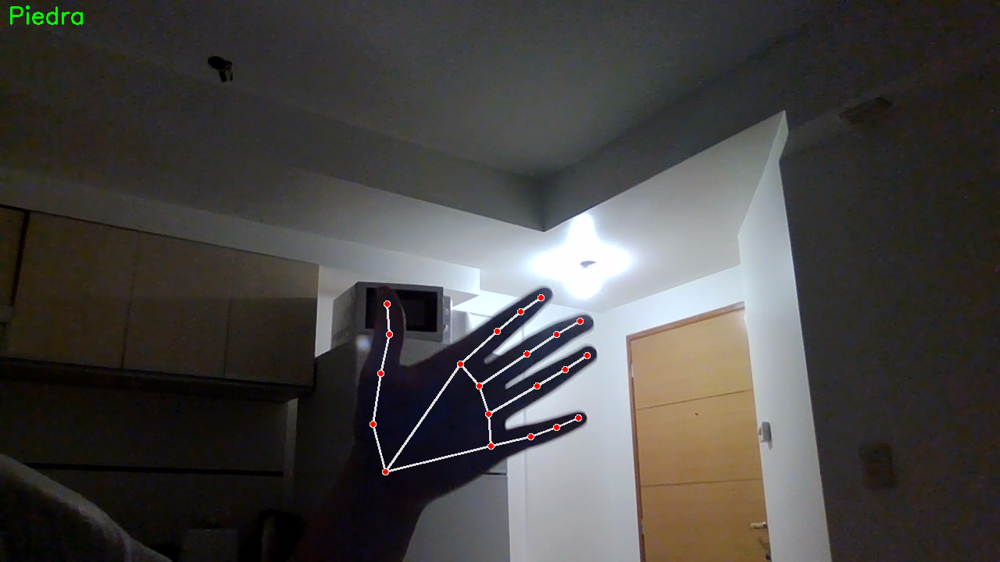

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


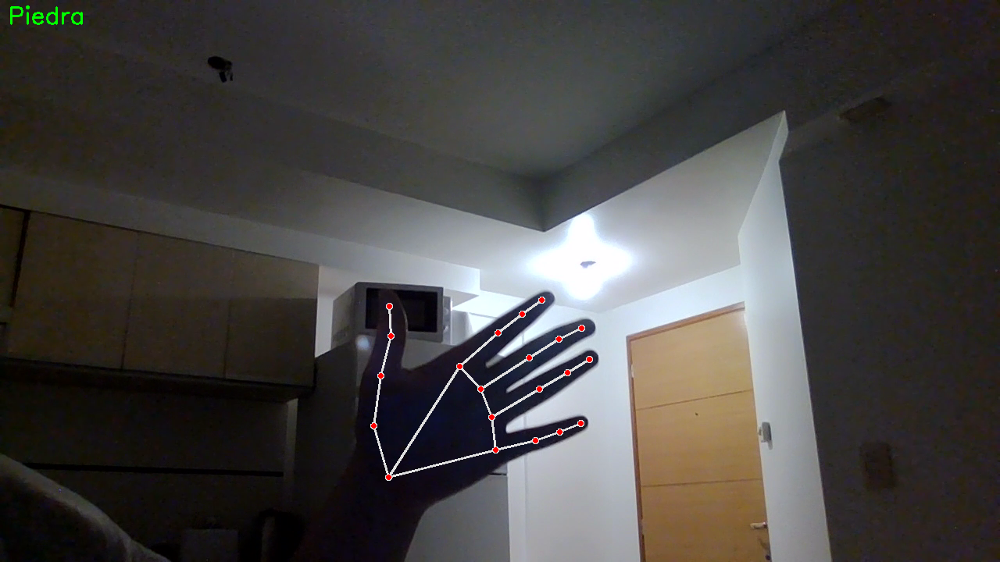

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step


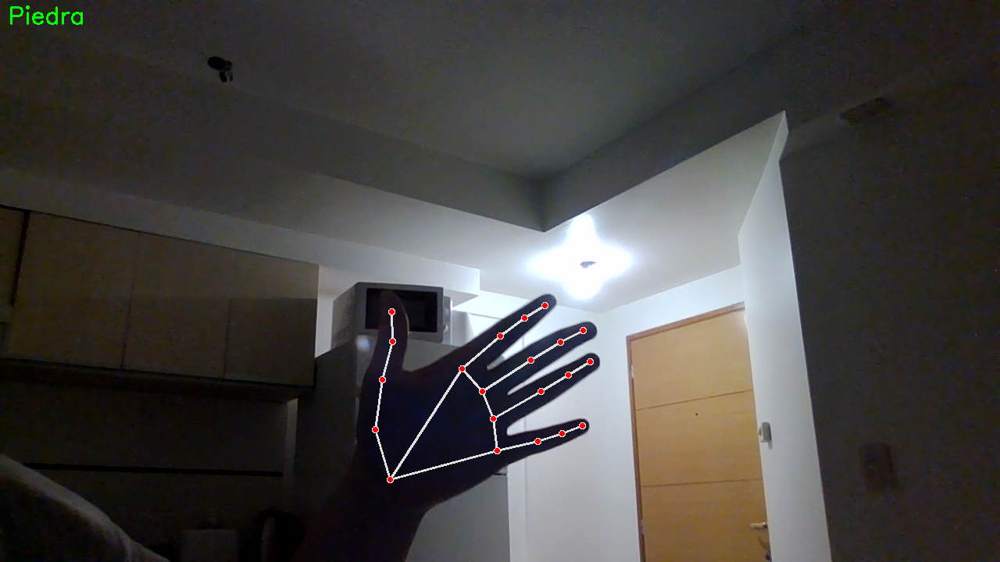

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


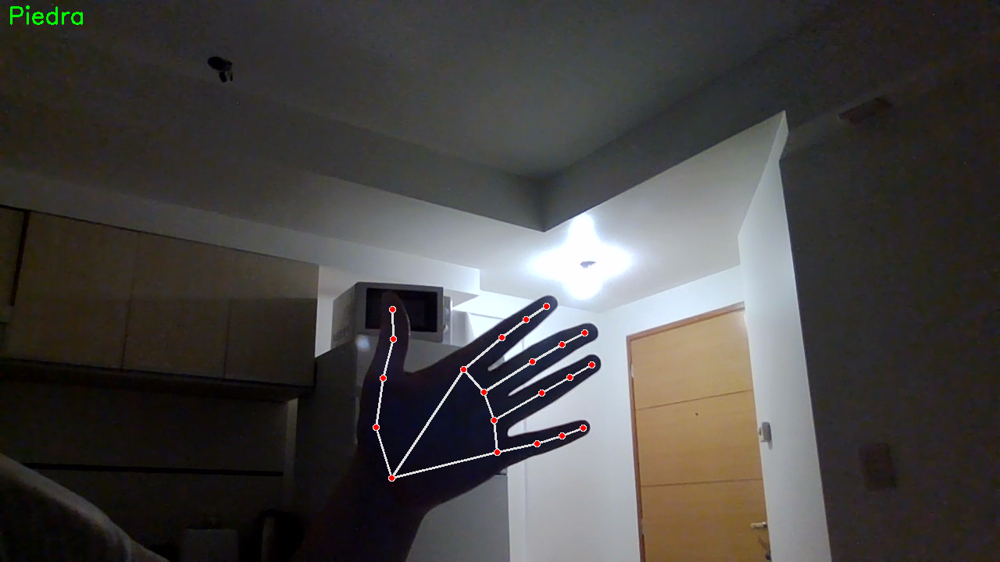

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


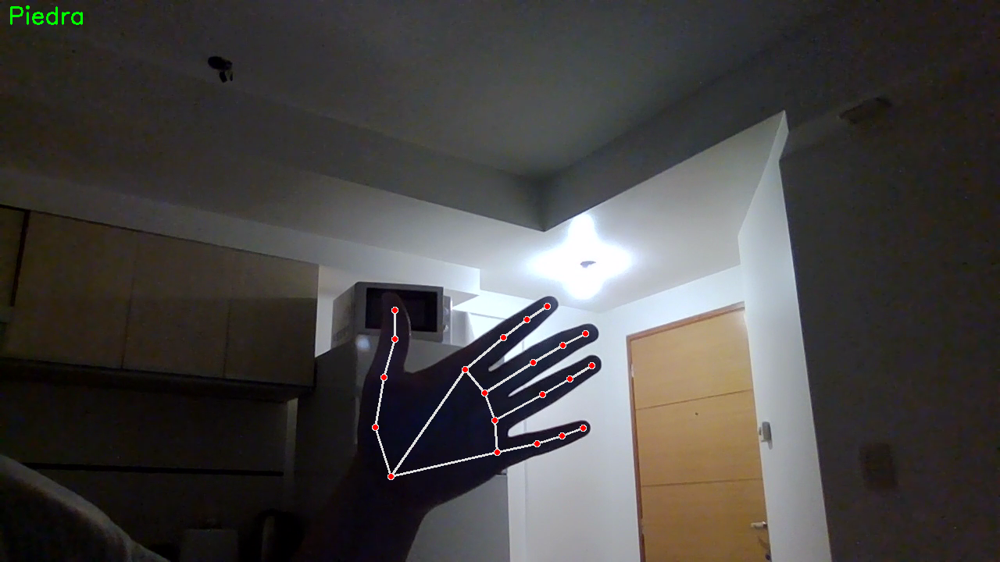

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


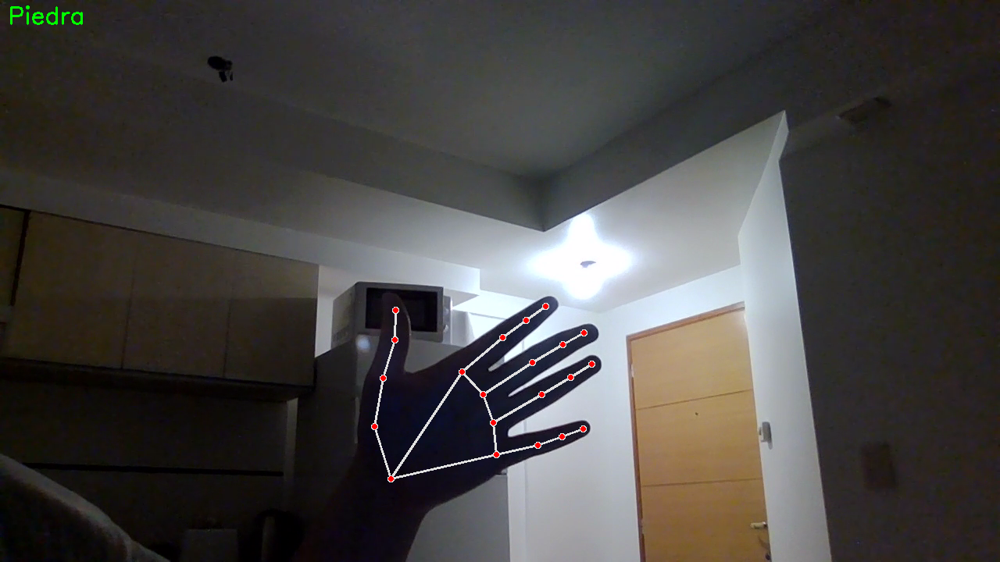

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


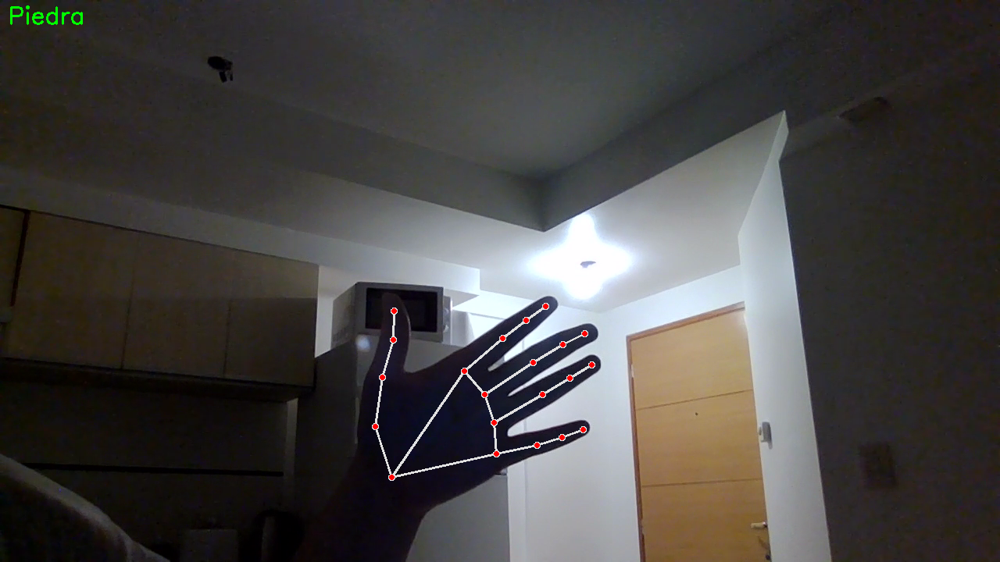

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


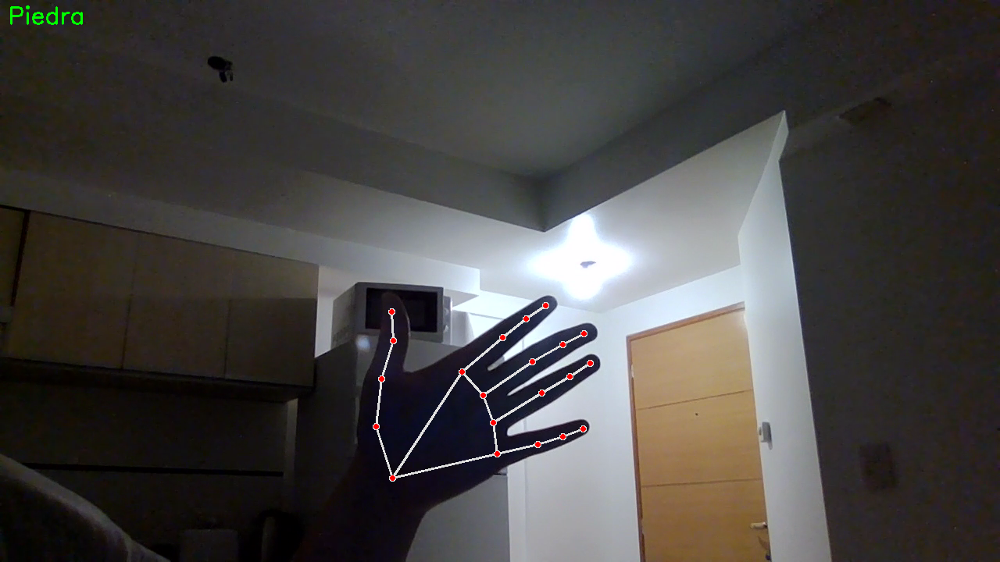

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


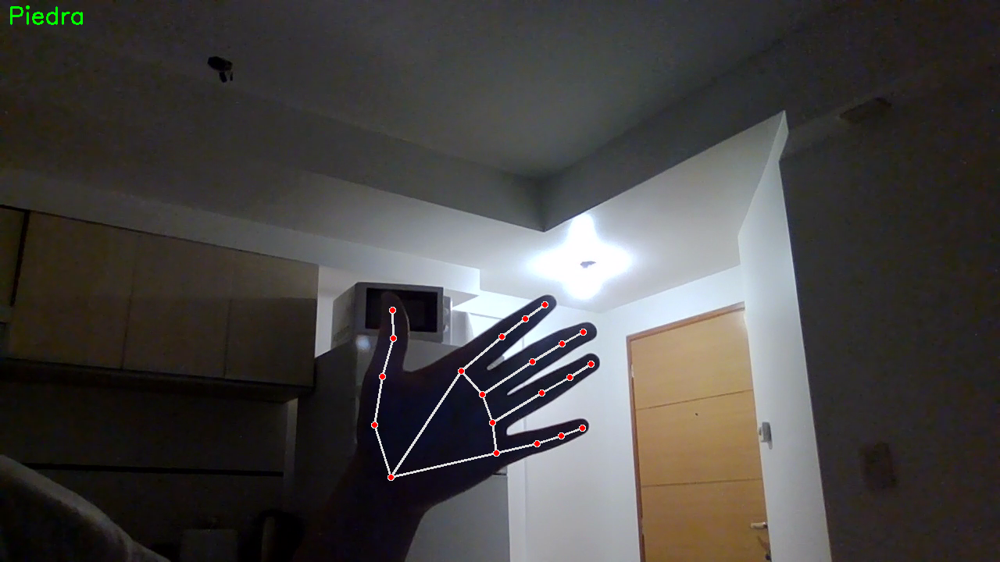

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


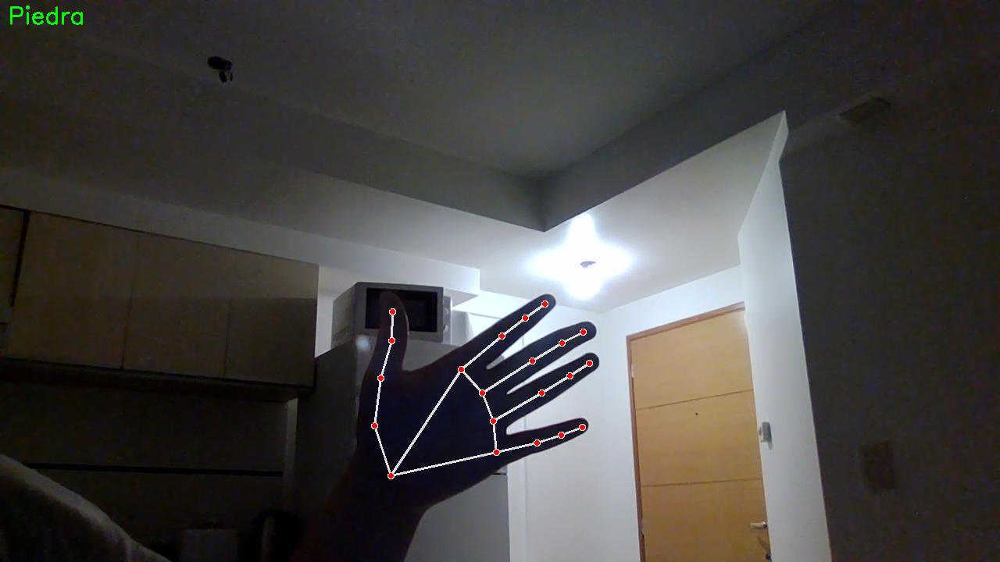

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step


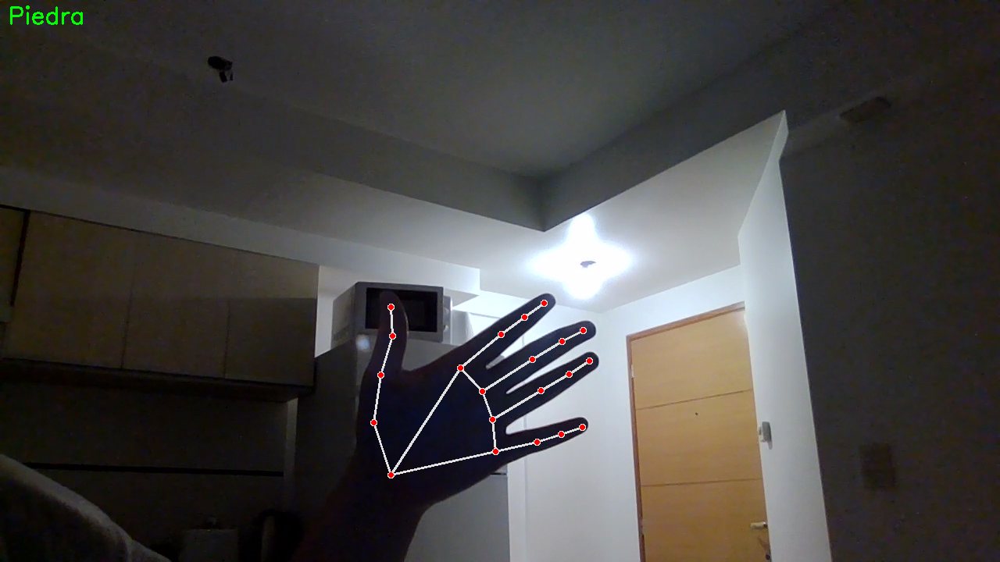

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


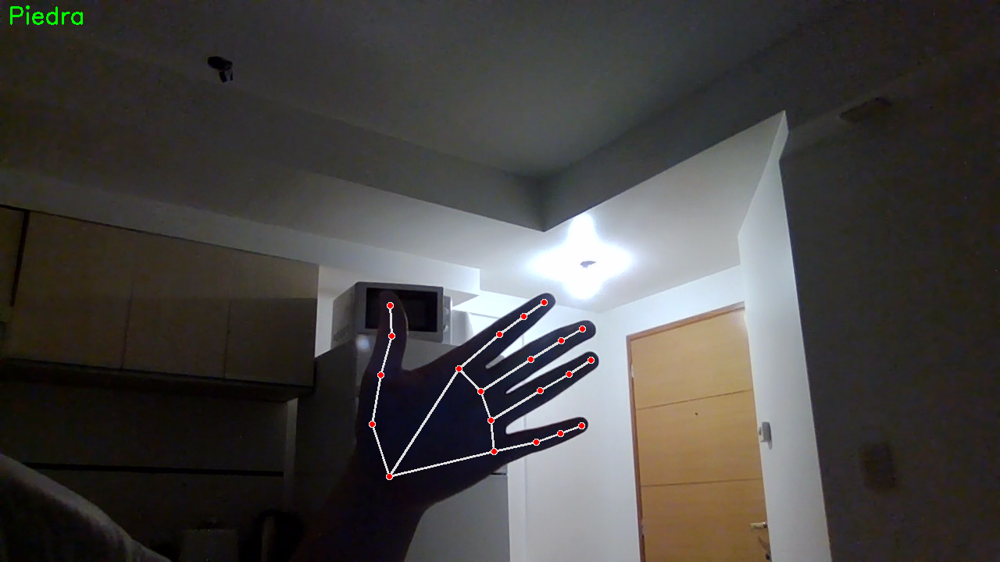

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


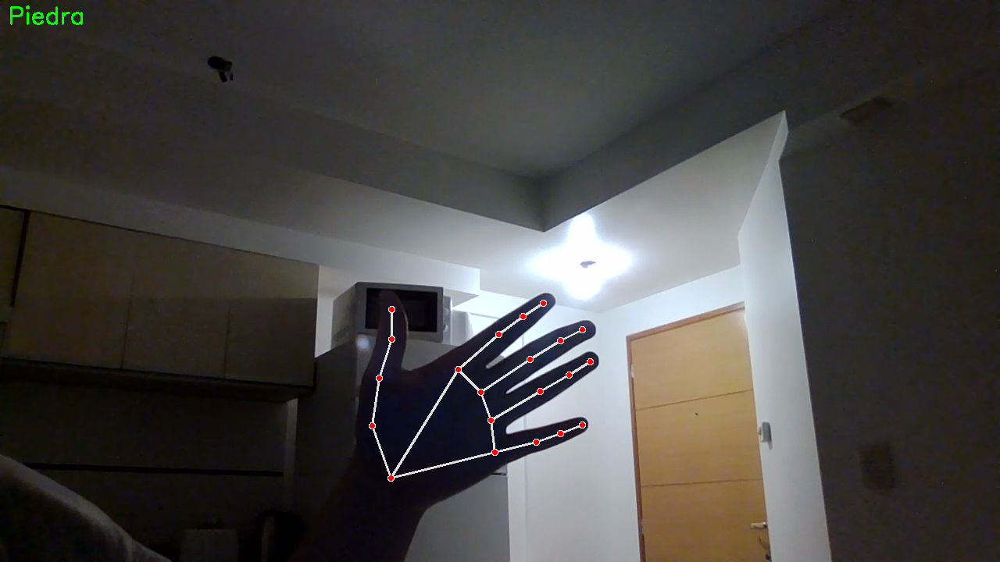

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


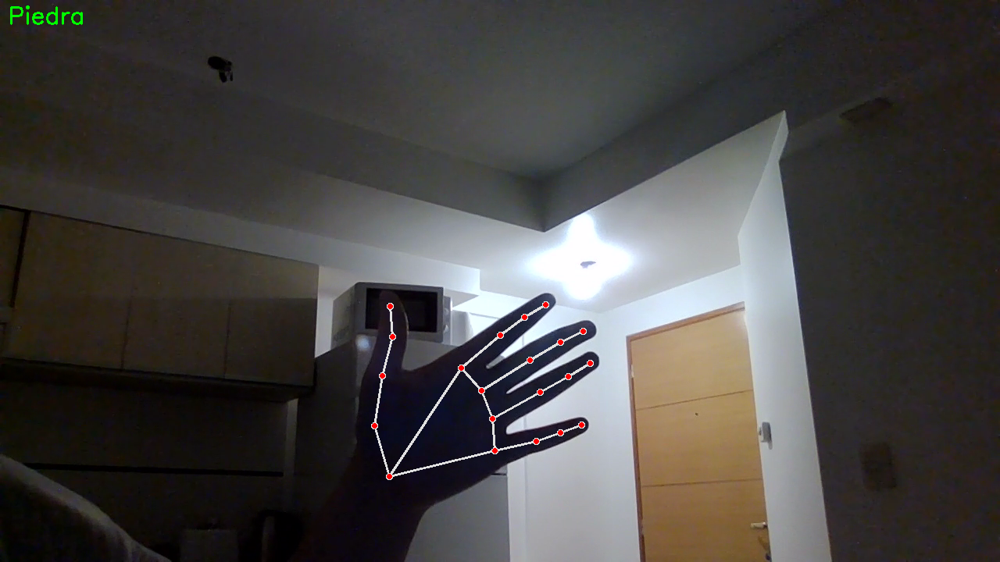

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


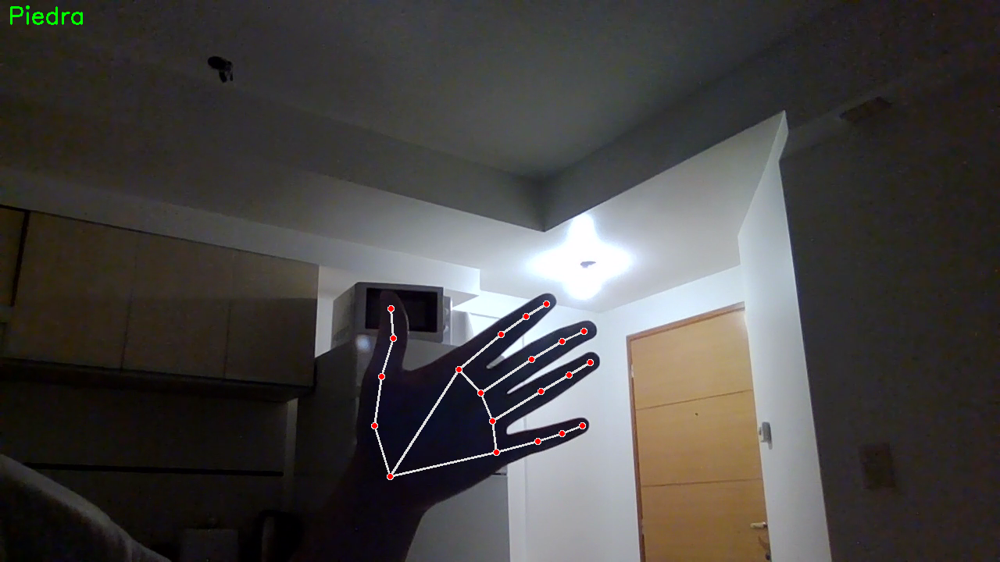

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step


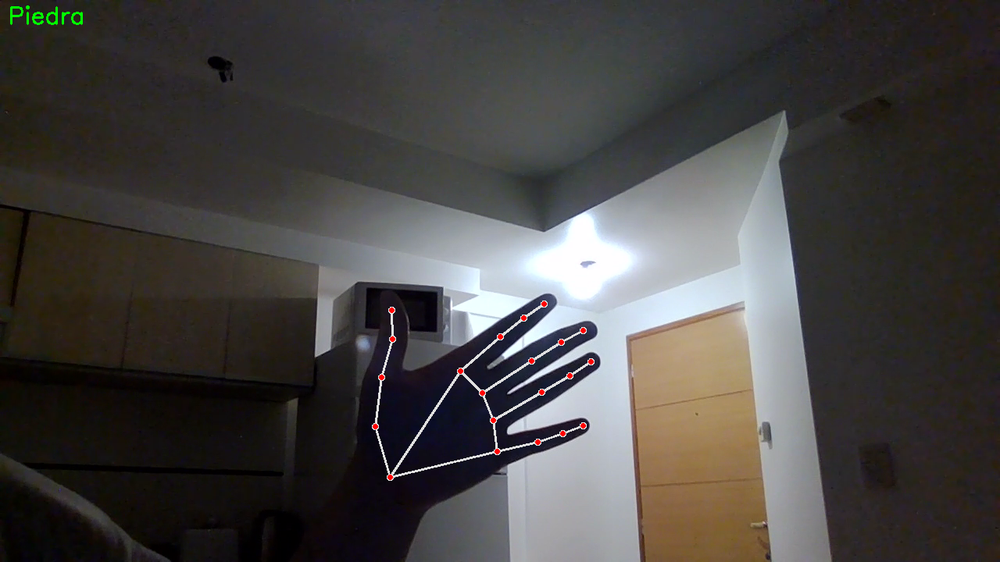

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step


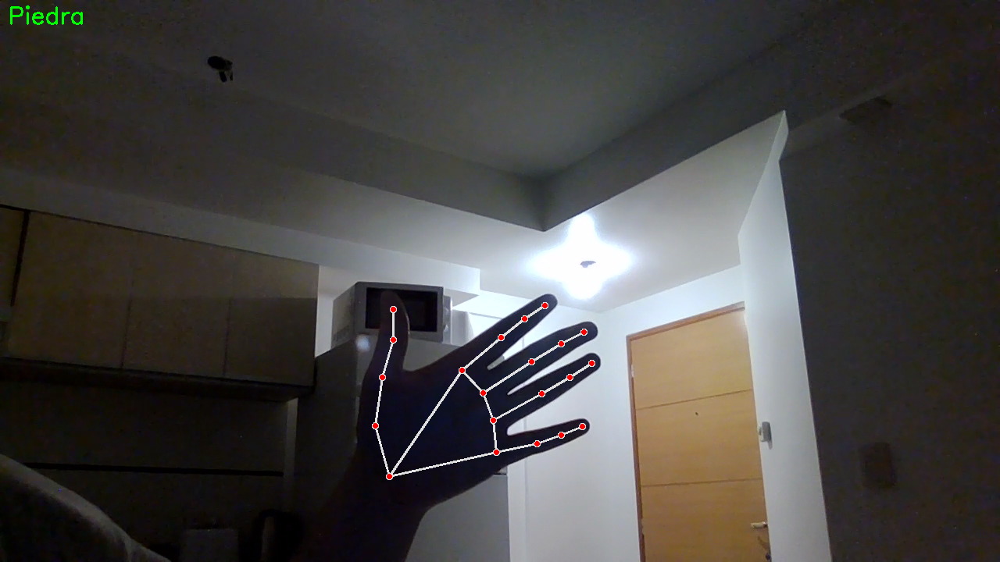

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


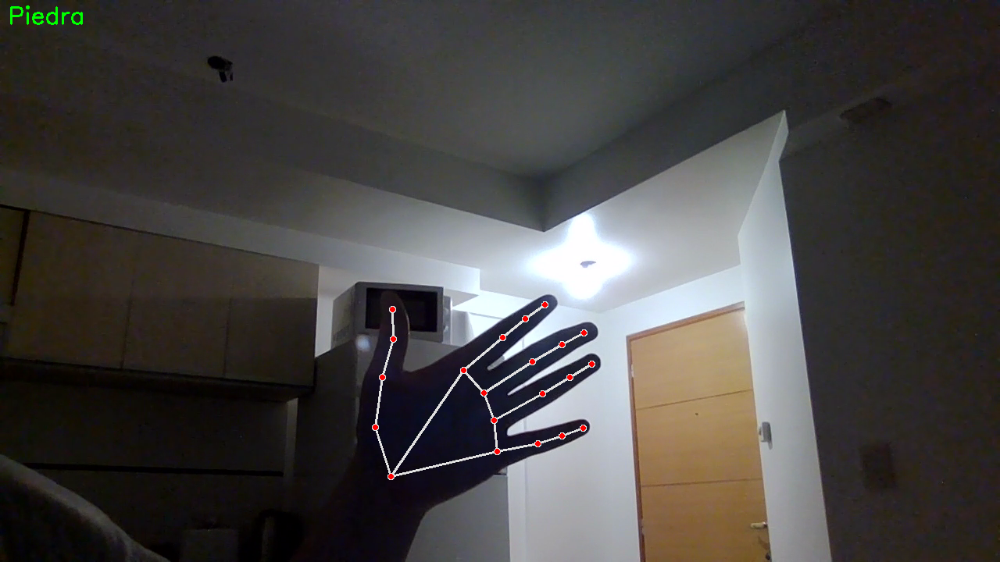

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


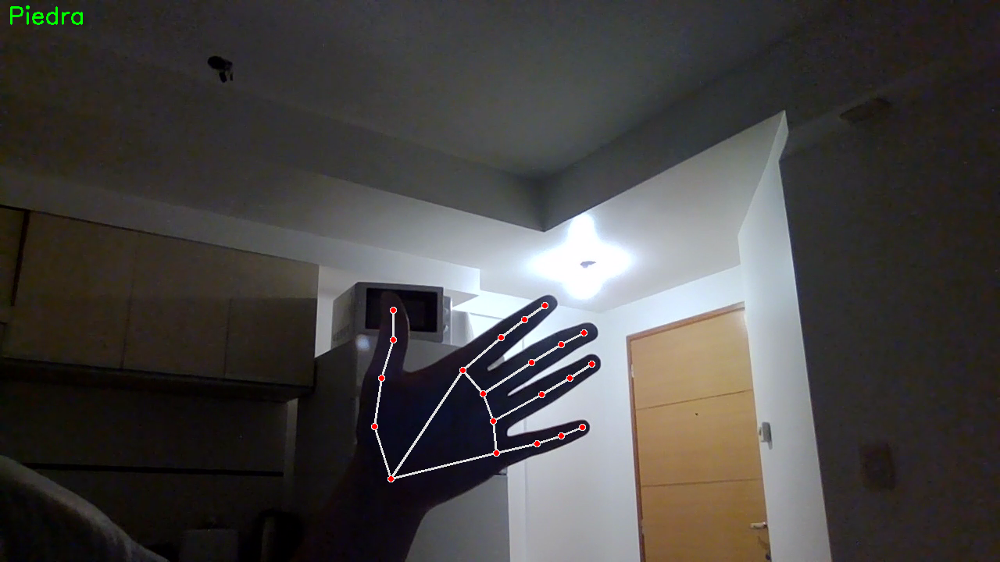

In [ ]:

from tensorflow.keras.models import load_model
from google.colab.patches import cv2_imshow


model = load_model('rps_model.h5')

model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

mp_hands = mp.solutions.hands
hands = mp_hands.Hands(static_image_mode=False, max_num_hands=1, min_detection_confidence=0.7)
mp_drawing = mp.solutions.drawing_utils


gestures = {0: "Piedra", 1: "Papel", 2: "Tijeras"}


video_path = 'Gestos.mp4'
cap = cv2.VideoCapture(video_path)

# Función para predecir el gesto basado en los landmarks
def predict_gesture(landmark_coords):
    # Aplanar las coordenadas de los landmarks y hacer la predicción
    landmark_array = np.array(landmark_coords).flatten().reshape(1, -1)
    prediction = model.predict(landmark_array)
    return np.argmax(prediction)

# Procesar el video y clasificar los gestos
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Convertir el frame a RGB
    image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = hands.process(image)

    # Si se detecta una mano
    if results.multi_hand_landmarks:
        for hand_landmarks in results.multi_hand_landmarks:
            landmark_coords = []
            for landmark in hand_landmarks.landmark:
                landmark_coords.append([landmark.x, landmark.y])

            # Dibujar los landmarks en la imagen
            mp_drawing.draw_landmarks(frame, hand_landmarks, mp_hands.HAND_CONNECTIONS)

            # Predecir el gesto
            gesture_id = predict_gesture(landmark_coords)
            gesture_name = gestures[gesture_id]


            cv2.putText(frame, gesture_name, (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)


    cv2_imshow(frame)


    if cv2.waitKey(1) & 0xFF == ord('q'):
        break


cap.release()
cv2.destroyAllWindows()
